# A random tale involving `rand`, as a start for the Brisbane Julia Language Meetup
## April 21, 2021, https://www.meetup.com/brisbane-julia-language-meetup

#### This notebook created by [Yoni Nazarathy](https://yoninazarathy.com/) - an $\approx$ 20 minute presentation prior to the main workshops of the evening by [Chris Foster](https://www.linkedin.com/in/chris-foster-b17a21107/?originalSubdomain=au) and [Andy Ferris](https://www.linkedin.com/in/andrewjamesferris/?originalSubdomain=au) 

#### See the GitHub repo [JuliaBrisbaneMeetup](https://github.com/c42f/JuliaBrisbaneMeetup) for this notebook and other content of the Brisbane Julia Language Meetup.

In [1]:
rand() #A default pseudo-random number in the interval $[0,1]$

0.7204199468802588

`rand` is a function.

In [2]:
rand

rand (generic function with 70 methods)

In [3]:
methods(rand)

# 70 methods for generic function "rand":
[1] rand() in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/Random.jl:256
[2] rand(dims::Integer...) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/Random.jl:277
[3] rand(rng::Random.AbstractRNG, sp::Random.Masked) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/Random.jl:234
[4] rand(rng::Random.AbstractRNG, sp::Random.SamplerRangeFast{UInt32, T}) where T in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:220
[5] rand(rng::Random.AbstractRNG, sp::Random.SamplerRangeFast{UInt64, T}) where T in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:227
[6] rand(rng::Random.AbstractRNG, sp::Random.SamplerRangeFast{UInt128, T}) where T in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:234
[7] rand(rng::Random.AbstractRNG, ::Random.UniformT{T}) where T in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/Random.jl:242
[8] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt104{UInt128}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:126
[9] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt52{UInt64}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:125
[10] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt23{UInt32}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:124
[11] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt10{UInt16}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:123
[12] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt23Raw{UInt32}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:112
[13] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.UInt10Raw{UInt16}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:111
[14] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.CloseOpen01{Float64}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:35
[15] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.CloseOpen01{Float32}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:29
[16] rand(r::Random.AbstractRNG, ::Random.SamplerTrivial{Random.CloseOpen01{Float16}, E} where E) in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:25
[17] rand(rng::Random.AbstractRNG, sp::Random.SamplerTrivial{Tuple{A}, E} where E) where A in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:495
[18] rand(rng::Random.AbstractRNG, sp::Random.SamplerRangeNDL{U, T}) where {U, T} in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:330
[19] rand(r::Random.AbstractRNG, ::Random.SamplerType{Complex{T}}) where T<:Real in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:159
[20] rand(r::Random.AbstractRNG, ::Random.SamplerType{T}) where T<:AbstractChar in Random at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Random/src/generation.jl:165
[21] rand

**Question:** Why would I want a method of the form  `rand(rng::Random.AbstractRNG, ...)`? We'll get to that soon... but first just another "random" example or two...

### Inspired from the "Cauchy Distribution Example" in Chapter 3 of *Statistics with Julia: Fundamentals for Data Science, Machine Learning and Artificial Intelligence* by Yoni Nazarathy and Hayden Klok.

See: https://statisticswithjulia.org/

In [4]:
using Plots

n = 10^6
data = 2*rand(n) .- 1
averages = accumulate(+,data)./(1:n)

plot(1:n, averages, c=:blue, legend=:none, xscale=:log10, xlims=(1,n), xlabel="n", ylabel="Running average")

Taken from https://github.com/h-Klok/StatsWithJuliaBook/blob/master/3_chapter/cauchyCMA.jl

In [5]:
using Plots

n = 10^6
trans(x) = tan(x*π - π/2) #use \pi + [TAB]
data = trans.(rand(n))
averages = accumulate(+,data)./(1:n)

plot( 1:n, averages, c=:blue, legend=:none, xscale=:log10, xlims=(1,n), xlabel="n", ylabel="Running average")

In [6]:
using Distributions
dist = Cauchy()

Cauchy{Float64}(μ=0.0, σ=1.0)

In [7]:
mean(dist)

NaN

In [8]:
for u in rand(10)
    @show quantile(dist,u), trans(u)
end

(quantile(dist, u), trans(u)) = (0.09910959150094203, 0.09910959150094209)
(quantile(dist, u), trans(u)) = (12.023816769419774, 12.023816769419742)
(quantile(dist, u), trans(u)) = (0.10822578066018092, 0.10822578066018089)
(quantile(dist, u), trans(u)) = (-0.9426387562194948, -0.9426387562194948)
(quantile(dist, u), trans(u)) = (0.6930169364838338, 0.6930169364838337)
(quantile(dist, u), trans(u)) = (0.7197299290608219, 0.7197299290608217)
(quantile(dist, u), trans(u)) = (8.352669082666932, 8.352669082666932)
(quantile(dist, u), trans(u)) = (0.6064686786463944, 0.6064686786463948)
(quantile(dist, u), trans(u)) = (-0.42716701068512036, -0.4271670106851203)
(quantile(dist, u), trans(u)) = (-0.649866371114703, -0.649866371114703)


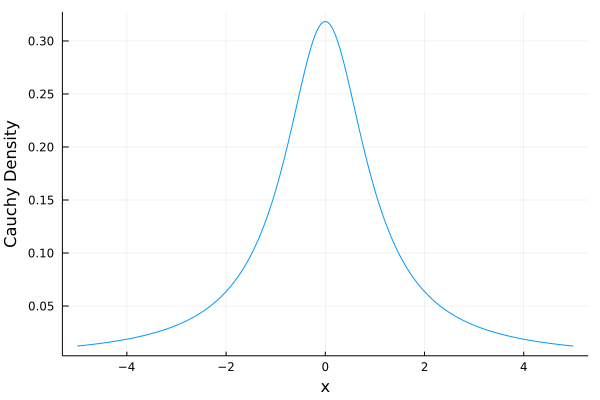

In [9]:
plot(-5:0.01:5, pdf.(dist,-5:0.01:5),legend=false,xlabel="x",ylabel="Cauchy Density")

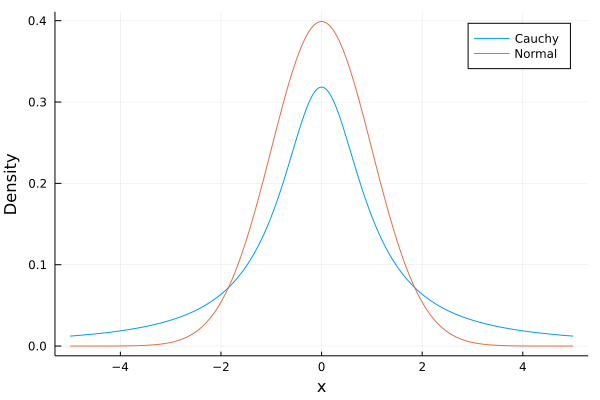

In [10]:
plot(-5:0.01:5, pdf.(dist,-5:0.01:5),xlabel="x",ylabel= "Density",label="Cauchy")
plot!(-5:0.01:5, pdf.(Normal(),-5:0.01:5),label="Normal")

**Back to the question:** Why would I want a method of the form  `rand(rng::Random.AbstractRNG, ...)`? 

### Inspired from "Section 10.6: Common Random Numbers and Multiple RNGs"  *Statistics with Julia*

$$
X=\sum_{i=1}^{N} Z_{i},
$$
where,
$$
N \sim \operatorname{Poisson}\big(K \lambda\big)
\qquad
\text{and}
\qquad Z_{i} \sim \operatorname{Uniform} \big(0,2(1-\lambda)\big)
$$
with $\lambda \in(0,1)$ and $K>0$.

**Question:** What is the mean of the random variable $X$?

**Answer:** Not particularly hard to see that it is $K \lambda(1-\lambda)$.

---

**Question:** For what value of $\lambda$ is the mean maximized?

**Answer:** Not particularly hard to see it is for $\lambda = 0.5$.

---

**Question:** How to see it via Monte Carlo with a limited simulation budget?

First back to the the RNG objects.

In [11]:
using Random
rng = MersenneTwister(22353)
rand(rng,5)

5-element Vector{Float64}:
 0.07791605778641442
 0.43028621778480525
 0.05059470783475173
 0.24664827201491635
 0.25280085316502676

In [12]:
typeof(rng)

MersenneTwister

In [13]:
ismutable(rng)

true

In [14]:
supertype(MersenneTwister)

AbstractRNG

In [15]:
supertype(AbstractRNG)

Any

Taken from https://raw.githubusercontent.com/h-Klok/StatsWithJuliaBook/master/10_chapter/twoRNGs.jl

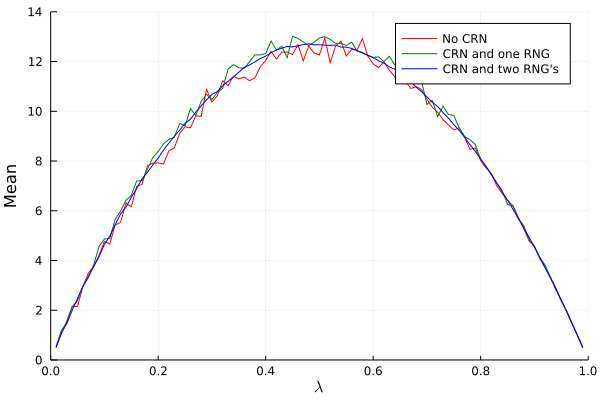

In [16]:
using Distributions, Random, Plots, LaTeXStrings

N, K = 10^2, 50
λRange = 0.01:0.01:0.99

prn(λ,rng) = quantile(Poisson(λ),rand(rng))
zDist(λ) = Uniform(0,2*(1-λ))

rv(λ,rng) = sum([rand(rng,zDist(λ)) for _ in 1:prn(K*λ,rng)])
rv2(λ,rng1,rng2) = sum([rand(rng1,zDist(λ)) for _ in 1:prn(K*λ,rng2)])

mEst(λ,rng) = mean([rv(λ,rng) for _ in 1:N])
mEst2(λ,rng1,rng2) = mean([rv2(λ,rng1,rng2) for _ in 1:N])

#naively without any "common random numbers"
function mGraph0(seed)
    singleRng = MersenneTwister(seed)
    [mEst(λ,singleRng) for λ in λRange]
end

#using common random numbers but one RNG
mGraph1(seed) = [mEst(λ,MersenneTwister(seed)) for λ in λRange]

#using two RNGs!!! One for Z (uniforms) and one for N (Poisson)
mGraph2(seed1,seed2) = [mEst2(λ,MersenneTwister(seed1),MersenneTwister(seed2)) for λ in λRange]

plot(λRange,mGraph0(1987), c=:red, label="No CRN")
plot!(λRange,mGraph1(1987), c=:green, label="CRN and one RNG")
plot!(λRange,mGraph2(1987,1988), c=:blue, label="CRN and two RNG's", xlims=(0,1), ylims=(0,14),
        xlabel=L"\lambda", ylabel = "Mean")

In [17]:
M = 10^3
argMaxLam(graph) = λRange[findmax(graph)[2]]

std0 = std([argMaxLam(mGraph0(seed)) for seed in 1:M])
std1 = std([argMaxLam(mGraph1(seed)) for seed in 1:M])
std2 = std([argMaxLam(mGraph2(seed,seed+M)) for seed in 1:M])

println("Standard deviation with no CRN: ", round(std0,digits=3))
println("Standard deviation with CRN and single RNG: ", round(std1,digits=3))
println("Standard deviation with CRN and two RNGs: ", round(std2,digits=3))

Standard deviation with no CRN: 0.037
Standard deviation with CRN and single RNG: 0.034
Standard deviation with CRN and two RNGs: 0.015
